## Regression based wind direction forecasting

This notebook allows for scalable, clean model frameworks for applying different regression model types as functions of sepcified time horizons, parameters, training data, etc.

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge, Lasso, LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

### Model Code

#### Data Parsing Processes

In [169]:
def parse_temporal_data(data_df, T, temporal_resolution=15*60, features=["t", "wind_direction"]):
    ''' 
    Parses data into all possible 3 interval datasets (t1, t2, t3) within the data's time range. Inputted data_df must include the columns "t" and "wind_direction".
    
    param data_df : pd.DataFrame : original data to process and parse in preparation for regression
    param T : int : interval size (seconds) to train and forecast wind direction over
    param temporal_res : int : temporal resolution of data (seconds) (original NREL data is 15 mins)
    param features : [str] : list of column names in data_df corresponding to parameters to train and fit model to (both X and y)

    returns [pd.DataFrame] : list of dataframes where each corresponds to all possible datasets of t1, t2, t3 each interval of size T 
    '''
    # number of total model forecasting runs that can be done
    num_intervals = int(data_df.shape[0]/(T/(temporal_resolution)))
    # store all the t1-t3 set dataframes
    parse_model_datasets = []
    starting_t = data_df.t.values[0]

    for i in range(1,num_intervals+1):
        try:
            parse_model_data = pd.DataFrame()
            # past time interval from t_initial -> t_final - 2T
            t1_condition = ((data_df.t >= starting_t) & (data_df.t < starting_t + T))
            # present time interval from t_initial + T -> t_final - T
            t2_condition = ((data_df.t >= starting_t + 1*T -1) & (data_df.t < starting_t + 2*T))
            # future time interval goes from t_0 + 2T -> t_final
            t3_condition = ((data_df.t >= starting_t + 2*T -1) & (data_df.t < starting_t + 3*T))
            
            for feature in features:
                # y feature wind direction
                if feature=="wind_direction":
                    parse_model_data["wd_t1"] = data_df[feature][t1_condition].values
                    parse_model_data["wd_sin_t1"] = np.sin(np.deg2rad(data_df[feature][t1_condition].values))
                    parse_model_data["wd_cos_t1"] = np.cos(np.deg2rad(data_df[feature][t1_condition].values))

                    parse_model_data["wd_t2"] = data_df[feature][t2_condition].values
                    parse_model_data["wd_sin_t2"] = np.sin(np.deg2rad(data_df[feature][t2_condition].values))
                    parse_model_data["wd_cos_t2"] = np.cos(np.deg2rad(data_df[feature][t2_condition].values))

                    parse_model_data["wd_t3"] = data_df[feature][t3_condition].values
                    parse_model_data["wd_sin_t3"] = np.sin(np.deg2rad(data_df[feature][t3_condition].values))
                    parse_model_data["wd_cos_t3"] = np.cos(np.deg2rad(data_df[feature][t3_condition].values))
                    
                elif feature=="t":
                    parse_model_data[f"{feature}1"] = data_df[feature][t1_condition].values
                    parse_model_data[f"{feature}2"] = data_df[feature][t2_condition].values
                    parse_model_data[f"{feature}3"] = data_df[feature][t3_condition].values

                else:
                    parse_model_data[f"{feature}_t1"] = data_df[feature][t1_condition].values
                    parse_model_data[f"{feature}_t2"] = data_df[feature][t2_condition].values
                    parse_model_data[f"{feature}_t3"] = data_df[feature][t3_condition].values
                
            parse_model_datasets.append(parse_model_data)
            starting_t += T
        
        except Exception as e:
                print(f"Interval run {i} ", e)
                starting_t += T
                continue

    return parse_model_datasets

In [117]:
from datetime import datetime
from datetime import timedelta

def datenum_to_datetime(datenum):
    """
    Source: https://gist.github.com/victorkristof/b9d794fe1ed12e708b9d#file-datenum-to-datetime-py 
    Convert Matlab datenum into Python datetime.
    :param datenum: Date in datenum format
    :return:        Datetime object corresponding to datenum.
    """
    days = datenum % 1
    hours = days % 1 * 24
    minutes = hours % 1 * 60
    seconds = minutes % 1 * 60
    return datetime.fromordinal(int(datenum)) \
           + timedelta(days=int(days)) \
           + timedelta(hours=int(hours)) \
           + timedelta(minutes=int(minutes)) \
           + timedelta(seconds=round(seconds)) \
           - timedelta(days=366)

#### Regression Model

In [4]:
# regression to be used in the wind forecasting algorithm
def regression_base(X, y, regression_type=Ridge, lam=1.0):
    ''' 
    Develops a regression-based model of choice 
    param X : np.array : training X data
    param y : np.array : training y data
    param regression_type : sklearn.Linear_model : Ridge, Lasso, LogisticRegression 
    param lam : int : alpha coefficient of regression, a.k.a. penalty term to limit magnitude of coefficient
    '''
    # split X,y data into training and testing datasets
    test_size = 0.3 # test data represents 30% of full dataset
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=test_size)

    # fit model to training data
    model = regression_type(alpha=lam).fit(X_train, y_train)
    
    # calculate rsquared,  coefficient of determination
    R2_score = r2_score(y_val, model.predict(X_val))

    # compute regression train and test errors
    train_mse = (np.mean((y_train - model.predict(X_train))**2))
    val_mse = (np.mean((y_val - model.predict(X_val))**2))
    
    return model, train_mse, val_mse, R2_score

In [5]:
def split_training_testing_intervals_data(parsed_data, x_features, y_features, num_intervals=3):
    ''' 
    Splits the parsed data set and returns x, y data for each interval t1, t2, t3

    param x_features : [str] : list of column names in data_df corresponding to parameters to train and fit model to
    param y_features : [str] : list of column names in data_df corresponding to y outputs of model, i.e. wind direction

    returns dict {"t1" : [x_t1, y_t1, y_deg_t1], ..., "tn": x_tn, y_tn, y_deg_tn}
    '''
    interval_splits = {}
    for i in range(1,num_intervals+1):
        # get interval of t1 and wind direction at t1 (np.array format) (sin, cos, and true degrees)
        x_ti = parsed_data[[f"{feature}{i}" if feature=="t" else f"{feature}_t{i}" for feature in x_features]].fillna(0).to_numpy()
        y_ti = parsed_data[[f"{feature}_t{i}" for feature in y_features]].fillna(0).to_numpy()
        y_deg_ti = parsed_data[[f"wd_t{i}"]].fillna(0).to_numpy()

        interval_splits[f"t{i}"] = [x_ti, y_ti, y_deg_ti]

    return interval_splits
    

In [6]:
def run_regression(parsed_data, x_features, y_features, regression_type, T, historical_training_interval_count=1, temporal_resolution=15*60, lam=1.0):
    '''
    param parsed_data : pd.DataFrame : list of dataframes that holds data split into intervals of t1, t2, t3
        t1 : interval corresponding to current t - 2*T
        t2 : interval corresponding to t - T
        t3 : interval corresponding to t + T
    param x_features : [str] : list of column names in data_df corresponding to parameters to train and fit model to
    param y_features : [str] : list of column names in data_df corresponding to y outputs of model, i.e. wind direction
    param regression_type : str : type of linear regression (Ridge, Lasso, Logistic)
    param T : int : time horizon to forecast upon
    param historical_training_interval_count : int : number of intervals of data to include in training regression models
    param temporal_resolution : int : resolution of temporal data in seconds
    param lam : int : alpha coefficient of regression, a.k.a. penalty term

    '''
    # lists for storing results
    pred_approaches = list() # either regression or moving avg.
    model_num = list() # 1 or 2
    model_X_training_set = list() # X values for training
    model_y_training_set = list() # Y values (sin,cos) for training
    model_y_deg_training_set = list() # Y values (deg) for training
    model_y_pred_training_set = list() # fitted model y values for training set
    model_X_testing_set = list() # X values for test set
    model_y_testing_set = list() # Y values (sin,cos) for test set
    model_y_deg_testing_set = list() # Y values (deg) for test set
    train_mses = list()
    val_mses = list()
    # coeffs = list()
    std_devs = list()
    preds = list()
    pred_r2_scores = list()
    true_wind_dir = list()
    test_mses = list()

    data_interval_splits = split_training_testing_intervals_data(parsed_data, x_features, y_features)
    [x_t1, y_t1, y_deg_t1] = data_interval_splits["t1"]
    [x_t2, y_t2, y_deg_t2] = data_interval_splits["t2"]
    [x_t3, y_t3, y_deg_t3] = data_interval_splits["t3"]

    # store training datasets to lists
    pred_approaches.extend([regression_type]*2)
    model_num.extend(["1", "2"])
    model_X_training_set.extend([x_t1, x_t2])
    model_y_training_set.extend([y_t1, y_t2])
    model_y_deg_training_set.extend([y_deg_t1, y_deg_t2])
    true_wind_dir.extend([[y_deg_t2[:,0]], [y_deg_t3[:,0]]])

    # scale the training and testing datasets for models
    scaler = StandardScaler()
    X = np.concatenate((x_t1, x_t2, x_t3), axis=None)
    X_scaled = scaler.fit_transform(X.reshape(-1,1))
   
   # number of rows corresponding to T size intervals to parse three intervals of scaled data correctly
    T_num_rows = T//temporal_resolution
    x_t1_scaled = X_scaled[:T_num_rows]
    x_t2_scaled = X_scaled[T_num_rows:2*T_num_rows] # scaler.fit_transform(x_t2) + T # t2 and wind dir at t2 => test dataset for model 1
    x_t3_scaled =  X_scaled[2*T_num_rows:3*T_num_rows] # scaler.fit_transform(x_t3) + 2*T # t3 and wind dir at t3 => test dataset for model 2

    # train model 1 on t1 and wind_dir at t1
    model_1, train_mse_1, val_mse_1, R_squared_1 = regression_base(X=x_t1_scaled, y=y_t1, regression_type=regression_type, lam=lam)

    # train model 2 on t2 and wind_dir at t2
    model_2, train_mse_2, val_mse_2, R_squared_2 = regression_base(X=x_t2_scaled, y=y_t2, regression_type=regression_type, lam=lam)

    train_mses.extend([train_mse_1, train_mse_2])
    val_mses.extend([val_mse_1, val_mse_2])

    # store model X and y testing sets
    model_X_testing_set.extend([x_t2, x_t3])
    model_y_testing_set.extend([y_t2, y_t3])
    model_y_deg_testing_set.extend([y_deg_t2, y_deg_t3])

    # calculate mean squared error of model 1 predictions at t2 vs true t2 data
    mse_fit = np.mean(y_t2 - model_1.predict(x_t2_scaled)**2)
    mse_mean = np.mean((y_t2 - np.mean(y_t1))**2)
    
    # store fitted model to training set results
    model_1_fit_t1 = model_1.predict(x_t1_scaled)
    model_2_fit_t2 = model_2.predict(x_t2_scaled)
    model_y_pred_training_set.extend([model_1_fit_t1, model_2_fit_t2])

    # predictions from model 1 and 2 on future intervals
    pred_t2 = model_1.predict(x_t2_scaled)
    pred_t3 = model_2.predict(x_t3_scaled)

    # scale results and true values to calculate mses
    y_model_1_scaled = scaler.fit_transform(y_t2)
    y_model_2_scaled = scaler.fit_transform(y_t3)

    # calculate std and MSE for models 1 and 2
    std_dev_1 = np.std(y_t2 - pred_t2)
    test_mse_1 = np.mean((y_model_1_scaled - scaler.fit_transform(pred_t2))**2)
    prediction_r2_score_1 = r2_score(y_t2, pred_t2)
    std_dev_2 = np.std(y_t3 - pred_t3)
    test_mse_2 = np.mean((y_model_2_scaled - scaler.fit_transform(pred_t3))**2)
    prediction_r2_score_2 = r2_score(y_t3, pred_t3)

    # store results
    std_devs.extend([std_dev_1, std_dev_2])
    test_mses.extend([test_mse_1, test_mse_2])
    preds.extend([pred_t2, pred_t3])
    pred_r2_scores.extend([prediction_r2_score_1, prediction_r2_score_2])
    
    output = pd.DataFrame({"Model Approach": pred_approaches, "Model": model_num, "X Training set": model_X_training_set, 
                        "Y (cos,sin) Training set": model_y_training_set, "Y (deg) Training set": model_y_deg_training_set, 
                        "Model fit to training data (cos,sin)": model_y_pred_training_set, "Train MSE": train_mses, "Validation MSE": val_mses, 
                        "X Test set": model_X_testing_set, "Y (cos,sin) Test set": model_y_testing_set, "Y (deg) Test set": model_y_deg_testing_set, 
                        # "Coeffs": coeffs, 
                        "R squared": pred_r2_scores, "Std. Dev": std_devs, "Prediction (cos,sin)": preds, "Test MSE": test_mses})
    
    return output

In [7]:
def convert_predictions_to_degrees(results_df):
    ''' 
    Converts radians model fit and model predictions to degrees by 
        1. first splitting the cos, sin training fit & predictions into 4 columns, 
        2. finds the degrees of the corresponding cos, sin
    
    returns results_df with added columns : ["Model fit to training data (cos)", "Model fit to training data (sin)", "Prediction (cos)", 
                                            "Prediction (sin)", "Model fit to training data (deg)", "Prediction (deg)"]
    '''
    def get_degrees(cos, sin):
        '''
        cos : pd.DataFrame column
        sin : pd.DataFrame column

        return degrees corresponding to input sin and cos
        '''
        rad_cos = np.arccos(cos)
        rad_sin = np.arcsin(sin)
        rad_arctan = np.arctan2(sin,cos)
        if rad_cos.all() != rad_sin.all():
            raise Exception

        # wraps around 360°
        deg = np.rad2deg(rad_arctan)
        for i in range(len(deg)):
            if deg[i] < 0:
                deg[i] += 360

        return deg
    
    # split sin, cos results into separate columns
    results_df["Model fit to training data (cos)"] = results_df["Model fit to training data (cos,sin)"].apply(lambda x: x[:,0])
    results_df["Model fit to training data (sin)"] = results_df["Model fit to training data (cos,sin)"].apply(lambda x: x[:,1])
    results_df["Prediction (cos)"] = results_df["Prediction (cos,sin)"].apply(lambda x: x[:,0])
    results_df["Prediction (sin)"] = results_df["Prediction (cos,sin)"].apply(lambda x: x[:,1])
    
    train_fit_degrees = []
    test_pred_degrees = []
     # convert cos, sin -> degrees
    for i in range(results_df.shape[0]):
        train_fit_deg = get_degrees(results_df["Model fit to training data (cos)"][i], results_df["Model fit to training data (sin)"][i])
        train_fit_degrees.append(train_fit_deg)
        test_pred_deg = get_degrees(results_df["Prediction (cos)"][i], results_df["Prediction (sin)"][i])
        test_pred_degrees.append(test_pred_deg)
    
    results_df["Model fit to training data (deg)"] = train_fit_degrees
    results_df["Prediction (deg)"] = test_pred_degrees

    return results_df

In [173]:
def run_algorithm(data_df, T, temporal_resolution=15*60, x_features=["t"], y_features=["wind_direction"], model_type="Ridge", lam=1.0, historical_training_interval_count=1,height_meters=40):
    '''
    param T : int : the yaw set-point update period
    param R_min : minimum coefficient of determination value R-squared 
        (statistical measure in a regression model that determines the proportion of variance in the dependent variable 
        that can be explained by the independent variable.)
    param model_type : str : type of linear regression (Ridge or Lasso)
    param lam : int : alpha coefficient of regression, a.k.a. penalty term
    '''
    # parse model data to have time index and wind direction columns parsed by intervals t1, t2, t3
    parsed_model_data_sets = parse_temporal_data(data_df, T, temporal_resolution, x_features+y_features)

    # replace degree wind direction with cosine, sine values of wind direction in model output features
    if "wind_direction" in y_features:
        y_features = [feature for feature in y_features if feature!="wind_direction"]
        # y_features = y_features[:y_features.index("wind_direction")] +y_features[y_features.index("wind_direction"):]
        # y_features.remove("wind_direction")
        y_features.extend(["wd_cos", "wd_sin"])

    # initialize dataframe to store all results with first run of regression
    results_df = run_regression(parsed_model_data_sets[0], x_features, y_features, model_type, T, historical_training_interval_count, temporal_resolution, lam)

    for i in range(1,len(parsed_model_data_sets)):
        if parsed_model_data_sets[i].shape[0] == T/temporal_resolution:
            # get prediction results
            results_df_i = run_regression(parsed_model_data_sets[i], x_features, y_features, model_type, T, historical_training_interval_count, temporal_resolution, lam)
        
            # convert prediction radians results (cos, sin) -> degrees
            results_df_i = convert_predictions_to_degrees(results_df_i)

            # concatenate results to final dataframe
            results_df = pd.concat([results_df, results_df_i], ignore_index=True)
    
    return parsed_model_data_sets, results_df

#### Plotting

In [9]:
def plot_maker(model_method, t_interval_index, reg_lam,x_axis_range, y_axis_range):
    """
    Using matplotlib, create plot with set figure size, legend location, axes labels, etc. 
    This is currently design to meet specific helper needs for the function plot_true_v_pred_each_step()
    Returns ax plt.subplot with designated features
    """
    # create figure to plot it
    fig = plt.figure(figsize=(8, 6), dpi=80)
    ax = plt.subplot(111)
    # shrink axis by 20%
    box = ax.get_position()
    ax.set_position([box.x0,box.y0,box.width*0.8,box.height])
    # setting axes and titles
    ax.set_ylabel("Wind direction (deg)")
    ax.set_xlabel("Date Time")
    ax.set_title(f"{model_method} (alpha={reg_lam}) model results true v. predicted, run {t_interval_index}")
    
    ax.set_xlim(x_axis_range)
    ax.set_ylim(y_axis_range)
    
    return ax

In [10]:
def plot_true_v_pred(inputs, outputs, reg_lam, t_interval_index=0, height_meters=40):
    # filtering by model 1 and 2
    model_1_df = outputs.loc[outputs.Model == "1"]
    model_2_df = outputs.loc[outputs.Model == "2"]

    # model approach (regression or moving avg.)
    model_method = model_1_df[model_1_df.index==t_interval_index]["Model Approach"].values[0]
    
    # t indices
    t1 = model_1_df[model_1_df.index==t_interval_index]["X Training set"].values[0][:,0]
    t2 = model_1_df[model_1_df.index==t_interval_index]["X Test set"].values[0][:,0]
    t3 = model_2_df[model_2_df.index==t_interval_index+1]["X Test set"].values[0][:,0]

    # convert t indices to datetime
    t1_dt = pd.to_datetime(t1, unit="s")
    t2_dt = pd.to_datetime(t2, unit="s")
    t3_dt = pd.to_datetime(t3, unit="s")

    # target values
    y_t1 = model_1_df[model_1_df.index==t_interval_index]["Y (deg) Training set"].values[0][:,0]
    y_t2 = model_1_df[model_1_df.index==t_interval_index]["Y (deg) Test set"].values[0][:,0]
    y_t3 = model_2_df[model_2_df.index==t_interval_index+1]["Y (deg) Test set"].values[0][:,0]

    # model predictions
    training_model_1_fit = model_1_df[model_1_df.index==t_interval_index]["Model fit to training data (deg)"].values.tolist()[0]
    pred_t2 = model_1_df[model_1_df.index ==t_interval_index]["Prediction (deg)"].values.tolist()[0]

    training_model_2_fit = model_2_df[model_2_df.index==t_interval_index+1]["Model fit to training data (deg)"].values.tolist()[0]
    pred_t3 = model_2_df[model_2_df.index ==t_interval_index+1]["Prediction (deg)"].values.tolist()[0]

    # define axes limits
    x_axis_range = [t1_dt[0], t3_dt[-1]]
    y_axis_range = min([*y_t1, *y_t2, *y_t3, *training_model_1_fit, *pred_t2, *training_model_2_fit, *pred_t3]), \
        max([*y_t1, *y_t2, *y_t3, *training_model_1_fit, *pred_t2, *training_model_2_fit, *pred_t3])
    
    # create base plot
    ax = plot_maker(model_method, t_interval_index, reg_lam, x_axis_range, y_axis_range)

    # plot t1, t2, t3 predictions and targets
    ax.plot(t1_dt, y_t1, label=f"True wind dir ({height_meters}m) at t1", linestyle="solid", color="blue")
    ax.plot(t1_dt, training_model_1_fit, label=f"Model 1 fit to training data (t1)", linestyle="dotted", color="blue")
    ax.plot(t2_dt, y_t2, label=f"True wind dir ({height_meters}m) at t2", linestyle="solid", color="orange")  
    ax.plot(t2_dt, pred_t2, label=f"Predicted wind dir ({height_meters}m) at t2 (model 1)", linestyle="dashed", color="blue")
    ax.plot(t2_dt, training_model_2_fit, label=f"Model 2 fit to training data (t2)", linestyle="dotted", color="orange")
    ax.plot(t3_dt, y_t3, label=f"True wind dir ({height_meters}m) at t3", linestyle="solid", color="green")
    ax.plot(t3_dt, pred_t3, label=f"Predicted wind dir ({height_meters}m) at t3 (model 2)", linestyle="dashed",color="orange")

    # moving legend outside of plot
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()

In [11]:
def T_grid_search(data_df,T_range, temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count):
        all_model_results = {}
        all_train_mse = []
        all_validation_mse = []
        all_test_mse = []

        for T in T_range:
                print(f"Modeling for T = {T} s")
                model_inputs, model_results = run_algorithm(data_df, T, temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count)
                all_model_results[lam] = model_results
                # store MSE values in lists
                train_model_mse = np.average(model_results["Train MSE"].values)
                all_train_mse.append(train_model_mse)
                val_model_mse = np.average(model_results["Validation MSE"].values)
                all_validation_mse.append(val_model_mse)
                test_model_mse = np.average(model_results["Test MSE"].values)
                all_test_mse.append(test_model_mse)
                print("---------------")
        
        plt.plot(T_range, all_train_mse, label=f"Training MSE", linestyle="solid", color="blue")
        plt.title(f"Training and Test MSEs - T Grid Search (lam={lam})")
        plt.xlabel("T forecasting time horizon (s)")
        plt.ylabel("MSE")
        plt.legend()
        plt.show()

        plt.plot(T_range, all_test_mse, label=f"Test MSE", linestyle="solid", color="red")
        plt.title(f"Training and Test MSEs - T Grid Search (lam={lam})")
        plt.xlabel("T forecasting time horizon (s)")
        plt.ylabel("MSE")
        plt.legend()
        plt.show()

        return T_range, all_train_mse, all_validation_mse, all_test_mse, all_model_results

In [12]:
# experimenting with different penalty term (lambda) magnitudes
# initialize set of lambdas to conduct grid search over
def lambda_grid_search(data_df,lambdas, T, temporal_resolution,x_features, y_features, model_type, historical_training_interval_count):
        all_model_results = {}
        all_train_mse = []
        all_validation_mse = []
        all_test_mse = []

        for lam in lambdas:
                model_inputs, model_results = run_algorithm(data_df, T, temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count)
                all_model_results[lam] = model_results
                # store MSE values in lists
                train_model_mse = np.average(model_results["Train MSE"].values)
                all_train_mse.append(train_model_mse)
                val_model_mse = np.average(model_results["Validation MSE"].values)
                all_validation_mse.append(val_model_mse)
                test_model_mse = np.average(model_results["Test MSE"].values)
                all_test_mse.append(test_model_mse)
        
        plt.plot(lambdas, all_train_mse, label=f"Training MSE", linestyle="solid", color="blue")
        plt.title(f"Training and Test MSEs - Lambda Grid Search (T={T}s)")
        plt.xlabel("Lambda penalty term")
        plt.ylabel("MSE")
        plt.legend()
        plt.xscale('log')
        plt.show()

        plt.plot(lambdas, all_test_mse, label=f"Test MSE", linestyle="solid", color="red")
        plt.title(f"Training and Test MSEs - Lambda Grid Search (T={T}s)")
        plt.xlabel("Lambda penalty term")
        plt.ylabel("MSE")
        plt.legend()
        plt.xscale('log')
        plt.show()

        return lambdas, all_train_mse, all_validation_mse, all_test_mse, all_model_results

### Model Runs

#### NREL Data Model Runs
5-minute resolution data

In [24]:
NREL_temporal_resolution = 5*60 # [seconds]
NREL_T = NREL_temporal_resolution*12 # 12 rows of 5 mins -> 1 hr (in seconds)
x_features = ["t"]
y_features = ["wind_direction"]
model_type = Ridge
lam = 10**(-1)
historical_training_interval_count = 1
height_meters = 80

In [25]:
NREL_data_filepath = "../data/NREL data - 5min/all_NREL_india_wind_data_2014.csv" 
NREL_raw_data_df = pd.read_csv(f"{NREL_data_filepath}")
NREL_data_df = NREL_raw_data_df[["t", f"wind direction at {height_meters}m (deg)"]].rename(columns={f"wind direction at {height_meters}m (deg)": "wind_direction"})
NREL_data_df

,t,wind_direction
0,1388534400,62.14
1,1388534700,61.31
2,1388535000,60.62
3,1388535300,60.14
4,1388535600,59.77
...,...,...
105115,1420068900,44.55
105116,1420069200,41.05
105117,1420069500,36.84
105118,1420069800,33.19


In [27]:
parsed_model_NREL_data_sets = parse_temporal_data(NREL_data_df, NREL_T, NREL_temporal_resolution, x_features+y_features)
parsed_model_NREL_data_sets

Length of values (0) does not match length of index (12)
Length of values (0) does not match length of index (12)


[            t1          t2          t3  wd_t1  wd_sin_t1  wd_cos_t1  wd_t2  \
 0   1388534400  1388538000  1388541600  62.14   0.884092   0.467313  54.99   
 1   1388534700  1388538300  1388541900  61.31   0.877230   0.480070  54.42   
 2   1388535000  1388538600  1388542200  60.62   0.871385   0.490600  53.64   
 3   1388535300  1388538900  1388542500  60.14   0.867245   0.497882  52.64   
 4   1388535600  1388539200  1388542800  59.77   0.864011   0.503472  51.34   
 5   1388535900  1388539500  1388543100  59.44   0.861097   0.508440  49.87   
 6   1388536200  1388539800  1388543400  59.02   0.857347   0.514739  48.37   
 7   1388536500  1388540100  1388543700  58.43   0.852001   0.523540  47.13   
 8   1388536800  1388540400  1388544000  57.72   0.845448   0.534057  45.85   
 9   1388537100  1388540700  1388544300  56.99   0.838575   0.544785  44.61   
 10  1388537400  1388541000  1388544600  56.27   0.831663   0.555280  43.44   
 11  1388537700  1388541300  1388544900  55.64   0.8

In [28]:
model_inputs, model_results = run_algorithm(NREL_data_df, NREL_T, NREL_temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count)

Length of values (0) does not match length of index (12)
Length of values (0) does not match length of index (12)


/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb

#### Field Data Model Runs
1-minute resolution data

In [115]:
field_temporal_resolution = 60 # [seconds]
field_T = field_temporal_resolution*10 # 10 rows of 1 mins -> 10 mins (in seconds)
x_features = ["t"]
y_features = ["wind_direction"]
model_type = Ridge
lam = 10**(-1)
historical_training_interval_count = 1
height_meters = 80

In [116]:
field_data_filepath = "../data/Field data/BHR58.csv" 
raw_field_data_df = pd.read_csv(f"{field_data_filepath}").rename(columns={"Unnamed: 0": "t"})
field_data_df = raw_field_data_df[["t", "RelWndDir"]].rename(columns={"t": "t_mat", "RelWndDir": "wind_direction"})
field_data_df

,t_mat,wind_direction
0,737825.771528,-4.430492
1,737825.772222,2.149563
2,737825.772917,-2.633825
3,737825.773611,-1.487978
4,737825.774306,-5.336175
...,...,...
98595,737897.344444,21.362832
98596,737897.345139,6.223006
98597,737897.345833,6.990911
98598,737897.346528,8.156903


In [118]:
field_data_df["DateTime"] = field_data_df.t_mat.apply(datenum_to_datetime)
field_data_df["t"] = (field_data_df.DateTime - pd.Timestamp("1970-01-01")) // pd.Timedelta("1s")

In [119]:
field_data_df.iloc[390*10:].t.values[0]

1581077460

In [170]:
parsed_model_field_data_sets = parse_temporal_data(field_data_df, field_T, field_temporal_resolution, x_features+y_features)
parsed_model_field_data_sets

Interval run 389  Length of values (0) does not match length of index (10)
Interval run 390  Length of values (0) does not match length of index (10)
Interval run 393  Length of values (0) does not match length of index (10)
Interval run 394  Length of values (0) does not match length of index (10)
Interval run 793  Length of values (0) does not match length of index (10)
Interval run 794  Length of values (0) does not match length of index (10)
Interval run 865  Length of values (0) does not match length of index (10)
Interval run 866  Length of values (0) does not match length of index (10)
Interval run 940  Length of values (0) does not match length of index (10)
Interval run 941  Length of values (0) does not match length of index (10)
Interval run 1005  Length of values (0) does not match length of index (10)
Interval run 1006  Length of values (0) does not match length of index (10)
Interval run 1095  Length of values (0) does not match length of index (10)
Interval run 1096  Len

[           t1          t2          t3     wd_t1  wd_sin_t1  wd_cos_t1  \
 0  1580841060  1580841660  1580842260 -4.430492  -0.077250   0.997012   
 1  1580841120  1580841720  1580842320  2.149563   0.037508   0.999296   
 2  1580841180  1580841780  1580842380 -2.633825  -0.045953   0.998944   
 3  1580841240  1580841840  1580842440 -1.487978  -0.025967   0.999663   
 4  1580841300  1580841900  1580842500 -5.336175  -0.092999   0.995666   
 5  1580841360  1580841960  1580842560  0.640191   0.011173   0.999938   
 6  1580841420  1580842020  1580842620  1.583989   0.027642   0.999618   
 7  1580841480  1580842080  1580842680 -1.172555  -0.020464   0.999791   
 8  1580841540  1580842140  1580842740 -0.269495  -0.004704   0.999989   
 9  1580841600  1580842200  1580842800 -2.121695  -0.037022   0.999314   
 
       wd_t2  wd_sin_t2  wd_cos_t2     wd_t3  wd_sin_t3  wd_cos_t3  
 0  0.604945   0.010558   0.999944  7.567104   0.131687   0.991291  
 1 -4.428962  -0.077223   0.997014  6.751093  

In [174]:
field_model_inputs, field_model_results = run_algorithm(field_data_df, field_T, field_temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count)

Interval run 389  Length of values (0) does not match length of index (10)
Interval run 390  Length of values (0) does not match length of index (10)
Interval run 393  Length of values (0) does not match length of index (10)
Interval run 394  Length of values (0) does not match length of index (10)
Interval run 793  Length of values (0) does not match length of index (10)
Interval run 794  Length of values (0) does not match length of index (10)
Interval run 865  Length of values (0) does not match length of index (10)
Interval run 866  Length of values (0) does not match length of index (10)
Interval run 940  Length of values (0) does not match length of index (10)
Interval run 941  Length of values (0) does not match length of index (10)
Interval run 1005  Length of values (0) does not match length of index (10)
Interval run 1006  Length of values (0) does not match length of index (10)
Interval run 1095  Length of values (0) does not match length of index (10)
Interval run 1096  Len

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

Error: list index out of range
Error: index 0 is out of bounds for axis 0 with size 0
Error: list index out of range
Error: list index out of range


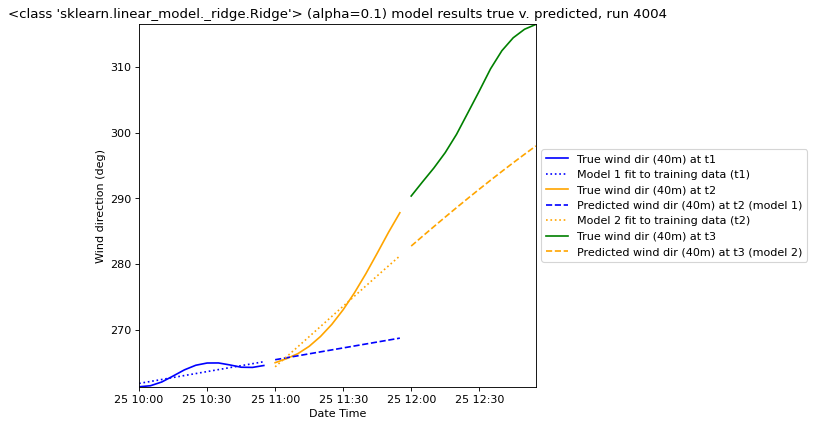

Error: index 0 is out of bounds for axis 0 with size 0


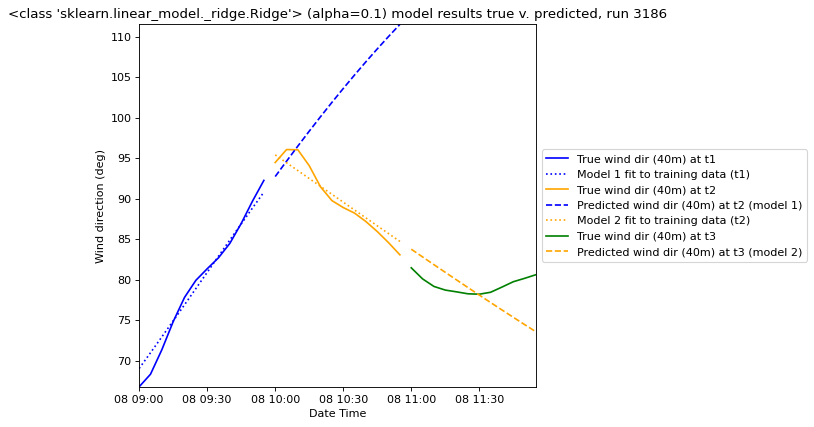

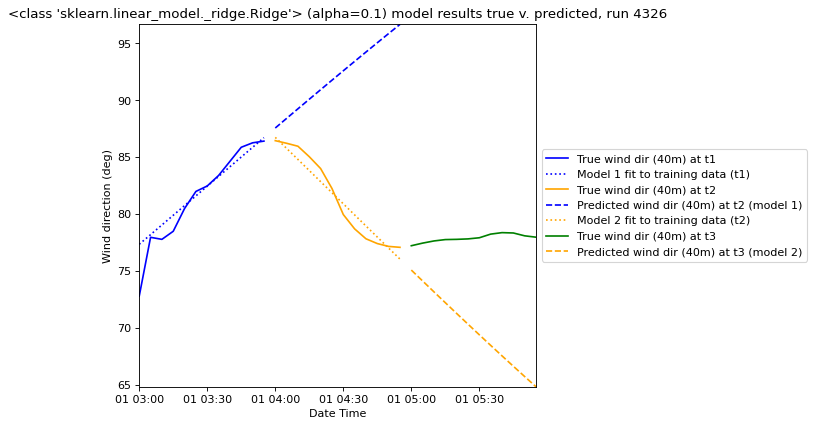

Error: list index out of range
Error: list index out of range
Error: list index out of range


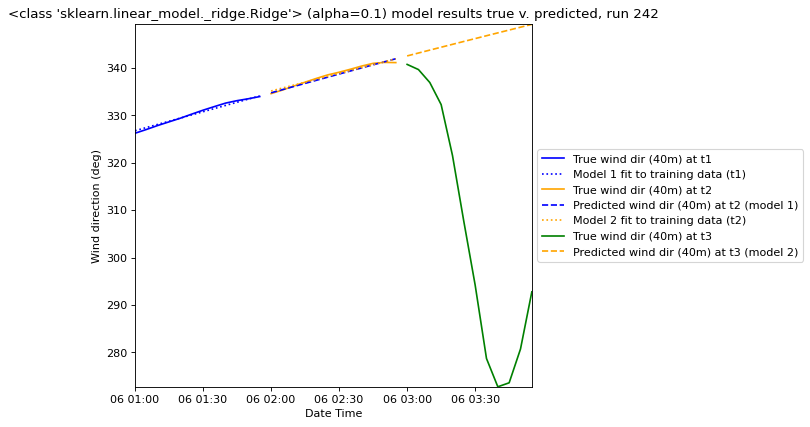

Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range


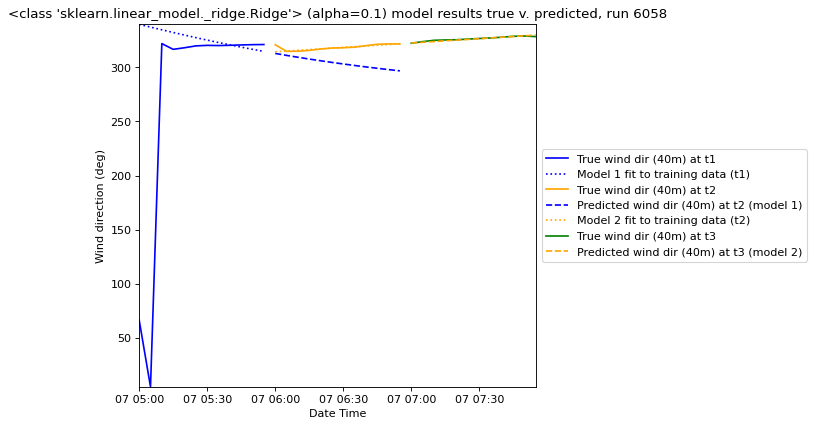

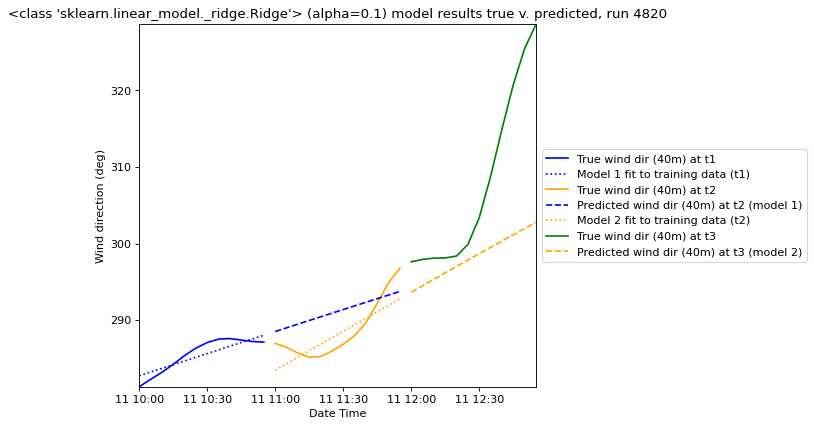

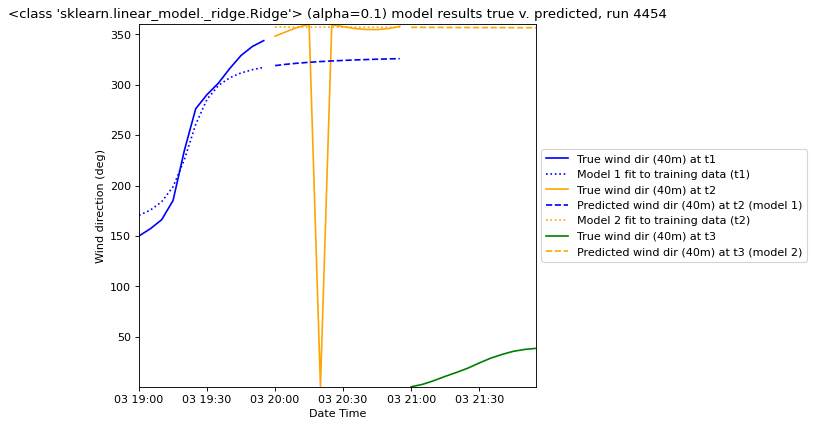

Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: index 0 is out of bounds for axis 0 with size 0
Error: index 0 is out of bounds for axis 0 with size 0
Error: list index out of range
Error: list index out of range


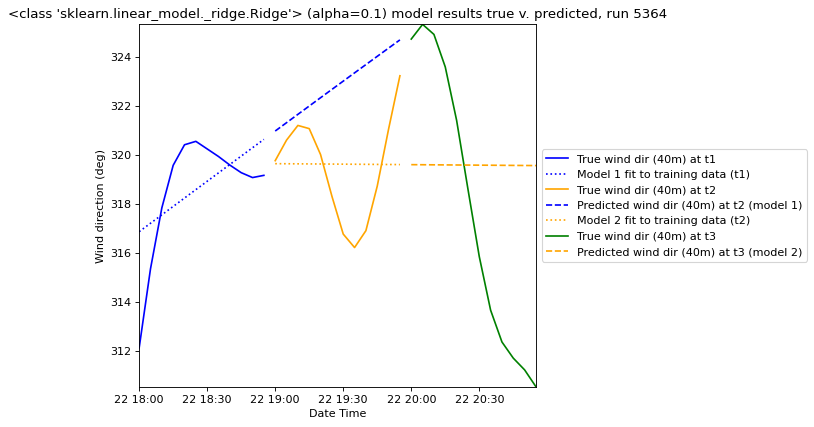

Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range


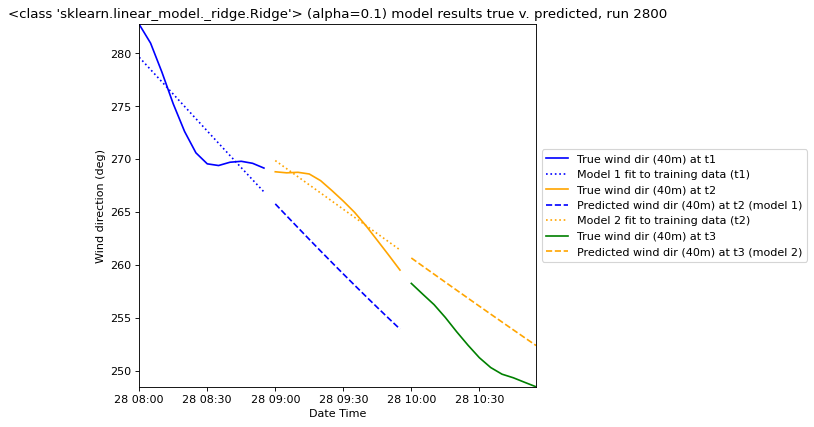

Error: list index out of range
Error: list index out of range


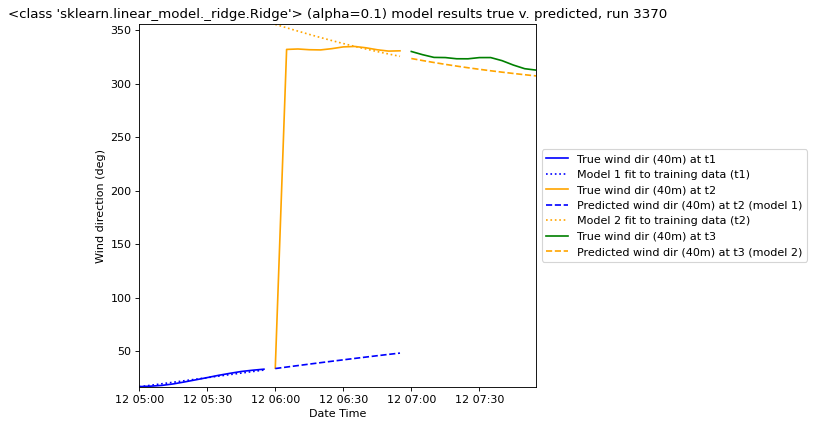

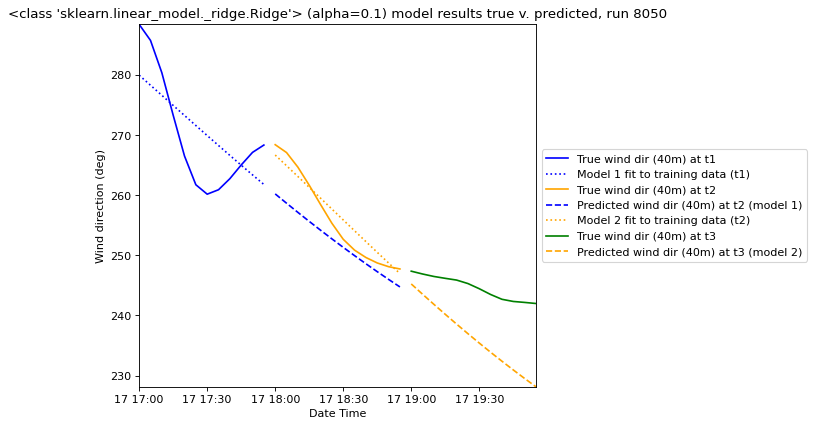

In [177]:
import random
count_plots = 0
max_plots = 10
for i in model_results.index.values:
    random_i = random.randint(0,model_results.shape[0])
    try:
        if count_plots > max_plots:
            break
        else:
            plot_true_v_pred(model_inputs[random_i], model_results, lam, t_interval_index=random_i)
            count_plots += 1

    except Exception as e:
        print(f"Error: {e}")
        continue

Modeling for T = 180 s
Interval run 1299  Length of values (0) does not match length of index (3)
Interval run 1300  Length of values (0) does not match length of index (3)
Interval run 1312  Length of values (0) does not match length of index (2)
Interval run 1313  Length of values (3) does not match length of index (2)
Interval run 1314  Length of values (3) does not match length of index (2)
Interval run 2645  Length of values (2) does not match length of index (3)
Interval run 2646  Length of values (2) does not match length of index (3)
Interval run 2647  Length of values (0) does not match length of index (2)
Interval run 2885  Length of values (0) does not match length of index (1)
Interval run 2886  Length of values (3) does not match length of index (1)
Interval run 2887  Length of values (3) does not match length of index (1)
Interval run 3135  Length of values (2) does not match length of index (3)
Interval run 3136  Length of values (2) does not match length of index (3)
In

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/var/folders/8s/cmks6vfx4vxb_x2clcgw

---------------
Modeling for T = 240 s
Interval run 974  Length of values (0) does not match length of index (4)
Interval run 975  Length of values (0) does not match length of index (4)
Interval run 984  Length of values (0) does not match length of index (4)
Interval run 985  Length of values (0) does not match length of index (4)
Interval run 1984  Length of values (0) does not match length of index (4)
Interval run 1985  Length of values (0) does not match length of index (4)
Interval run 2164  Length of values (0) does not match length of index (4)
Interval run 2165  Length of values (0) does not match length of index (4)
Interval run 2351  Length of values (2) does not match length of index (4)
Interval run 2352  Length of values (2) does not match length of index (4)
Interval run 2353  Length of values (0) does not match length of index (2)
Interval run 2514  Length of values (0) does not match length of index (4)
Interval run 2515  Length of values (0) does not match length of 

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 300 s
Interval run 779  Length of values (0) does not match length of index (5)
Interval run 780  Length of values (0) does not match length of index (5)
Interval run 787  Length of values (0) does not match length of index (5)
Interval run 788  Length of values (0) does not match length of index (5)
Interval run 1587  Length of values (0) does not match length of index (5)
Interval run 1588  Length of values (0) does not match length of index (5)
Interval run 1731  Length of values (0) does not match length of index (5)
Interval run 1732  Length of values (0) does not match length of index (5)
Interval run 1881  Length of values (0) does not match length of index (5)
Interval run 1882  Length of values (0) does not match length of index (5)
Interval run 2011  Length of values (0) does not match length of index (5)
Interval run 2012  Length of values (0) does not match length of index (5)
Interval run 2191  Length of values (0) does not match length of 

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 360 s
Interval run 649  Length of values (0) does not match length of index (6)
Interval run 650  Length of values (0) does not match length of index (6)
Interval run 655  Length of values (0) does not match length of index (2)
Interval run 656  Length of values (6) does not match length of index (2)
Interval run 657  Length of values (6) does not match length of index (2)
Interval run 1322  Length of values (2) does not match length of index (6)
Interval run 1323  Length of values (2) does not match length of index (6)
Interval run 1324  Length of values (0) does not match length of index (2)
Interval run 1442  Length of values (0) does not match length of index (4)
Interval run 1443  Length of values (6) does not match length of index (4)
Interval run 1444  Length of values (6) does not match length of index (4)
Interval run 1567  Length of values (2) does not match length of index (6)
Interval run 1568  Length of values (2) does not match length of i

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 420 s
Interval run 556  Length of values (1) does not match length of index (7)
Interval run 557  Length of values (1) does not match length of index (7)
Interval run 558  Length of values (0) does not match length of index (1)
Interval run 561  Length of values (0) does not match length of index (1)
Interval run 562  Length of values (7) does not match length of index (1)
Interval run 563  Length of values (7) does not match length of index (1)
Interval run 1133  Length of values (2) does not match length of index (7)
Interval run 1134  Length of values (2) does not match length of index (7)
Interval run 1135  Length of values (0) does not match length of index (2)
Interval run 1236  Length of values (0) does not match length of index (6)
Interval run 1237  Length of values (7) does not match length of index (6)
Interval run 1238  Length of values (7) does not match length of index (6)
Interval run 1343  Length of values (2) does not match length of in

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 480 s
Interval run 486  Length of values (4) does not match length of index (8)
Interval run 487  Length of values (4) does not match length of index (8)
Interval run 488  Length of values (0) does not match length of index (4)
Interval run 491  Length of values (0) does not match length of index (4)
Interval run 492  Length of values (8) does not match length of index (4)
Interval run 493  Length of values (8) does not match length of index (4)
Interval run 991  Length of values (4) does not match length of index (8)
Interval run 992  Length of values (4) does not match length of index (8)
Interval run 993  Length of values (0) does not match length of index (4)
Interval run 1081  Length of values (0) does not match length of index (4)
Interval run 1082  Length of values (8) does not match length of index (4)
Interval run 1083  Length of values (8) does not match length of index (4)
Interval run 1175  Length of values (2) does not match length of index

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 540 s
Interval run 432  Length of values (3) does not match length of index (9)
Interval run 433  Length of values (3) does not match length of index (9)
Interval run 434  Length of values (0) does not match length of index (3)
Interval run 436  Length of values (0) does not match length of index (2)
Interval run 437  Length of values (9) does not match length of index (2)
Interval run 438  Length of values (9) does not match length of index (2)
Interval run 881  Length of values (2) does not match length of index (9)
Interval run 882  Length of values (2) does not match length of index (9)
Interval run 883  Length of values (0) does not match length of index (2)
Interval run 961  Length of values (0) does not match length of index (7)
Interval run 962  Length of values (9) does not match length of index (7)
Interval run 963  Length of values (9) does not match length of index (7)
Interval run 1044  Length of values (5) does not match length of index (9

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 600 s
Interval run 389  Length of values (0) does not match length of index (10)
Interval run 390  Length of values (0) does not match length of index (10)
Interval run 393  Length of values (0) does not match length of index (10)
Interval run 394  Length of values (0) does not match length of index (10)
Interval run 793  Length of values (0) does not match length of index (10)
Interval run 794  Length of values (0) does not match length of index (10)
Interval run 865  Length of values (0) does not match length of index (10)
Interval run 866  Length of values (0) does not match length of index (10)
Interval run 940  Length of values (0) does not match length of index (10)
Interval run 941  Length of values (0) does not match length of index (10)
Interval run 1005  Length of values (0) does not match length of index (10)
Interval run 1006  Length of values (0) does not match length of index (10)
Interval run 1095  Length of values (0) does not match leng

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 660 s
Interval run 353  Length of values (6) does not match length of index (11)
Interval run 354  Length of values (6) does not match length of index (11)
Interval run 355  Length of values (0) does not match length of index (6)
Interval run 357  Length of values (0) does not match length of index (9)
Interval run 358  Length of values (11) does not match length of index (9)
Interval run 359  Length of values (11) does not match length of index (9)
Interval run 720  Length of values (9) does not match length of index (11)
Interval run 721  Length of values (9) does not match length of index (11)
Interval run 722  Length of values (0) does not match length of index (9)
Interval run 786  Length of values (0) does not match length of index (8)
Interval run 787  Length of values (11) does not match length of index (8)
Interval run 788  Length of values (11) does not match length of index (8)
Interval run 854  Length of values (5) does not match length of i

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 720 s
Interval run 324  Length of values (0) does not match length of index (12)
Interval run 325  Length of values (0) does not match length of index (12)
Interval run 327  Length of values (0) does not match length of index (8)
Interval run 328  Length of values (12) does not match length of index (8)
Interval run 329  Length of values (12) does not match length of index (8)
Interval run 660  Length of values (8) does not match length of index (12)
Interval run 661  Length of values (8) does not match length of index (12)
Interval run 662  Length of values (0) does not match length of index (8)
Interval run 720  Length of values (0) does not match length of index (4)
Interval run 721  Length of values (12) does not match length of index (4)
Interval run 722  Length of values (12) does not match length of index (4)
Interval run 783  Length of values (2) does not match length of index (12)
Interval run 784  Length of values (2) does not match length of 

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 780 s
Interval run 299  Length of values (0) does not match length of index (13)
Interval run 300  Length of values (0) does not match length of index (13)
Interval run 302  Length of values (0) does not match length of index (12)
Interval run 303  Length of values (13) does not match length of index (12)
Interval run 304  Length of values (13) does not match length of index (12)
Interval run 609  Length of values (10) does not match length of index (13)
Interval run 610  Length of values (10) does not match length of index (13)
Interval run 611  Length of values (0) does not match length of index (10)
Interval run 665  Length of values (0) does not match length of index (11)
Interval run 666  Length of values (13) does not match length of index (11)
Interval run 667  Length of values (13) does not match length of index (11)
Interval run 722  Length of values (11) does not match length of index (13)
Interval run 723  Length of values (11) does not match

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 840 s
Interval run 277  Length of values (8) does not match length of index (14)
Interval run 278  Length of values (8) does not match length of index (14)
Interval run 279  Length of values (0) does not match length of index (8)
Interval run 280  Length of values (0) does not match length of index (8)
Interval run 281  Length of values (14) does not match length of index (8)
Interval run 282  Length of values (14) does not match length of index (8)
Interval run 566  Length of values (2) does not match length of index (14)
Interval run 567  Length of values (2) does not match length of index (14)
Interval run 568  Length of values (0) does not match length of index (2)
Interval run 617  Length of values (0) does not match length of index (6)
Interval run 618  Length of values (14) does not match length of index (6)
Interval run 619  Length of values (14) does not match length of index (6)
Interval run 671  Length of values (2) does not match length of i

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 900 s
Interval run 259  Length of values (0) does not match length of index (15)
Interval run 260  Length of values (0) does not match length of index (15)
Interval run 261  Length of values (0) does not match length of index (5)
Interval run 262  Length of values (15) does not match length of index (5)
Interval run 263  Length of values (15) does not match length of index (5)
Interval run 528  Length of values (5) does not match length of index (15)
Interval run 529  Length of values (5) does not match length of index (15)
Interval run 530  Length of values (0) does not match length of index (5)
Interval run 576  Length of values (0) does not match length of index (10)
Interval run 577  Length of values (15) does not match length of index (10)
Interval run 578  Length of values (15) does not match length of index (10)
Interval run 626  Length of values (5) does not match length of index (15)
Interval run 627  Length of values (5) does not match length 

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 960 s
Interval run 242  Length of values (12) does not match length of index (16)
Interval run 243  Length of values (12) does not match length of index (16)
Interval run 244  Length of values (0) does not match length of index (12)
Interval run 245  Length of values (0) does not match length of index (12)
Interval run 246  Length of values (16) does not match length of index (12)
Interval run 247  Length of values (16) does not match length of index (12)
Interval run 495  Length of values (4) does not match length of index (16)
Interval run 496  Length of values (4) does not match length of index (16)
Interval run 497  Length of values (0) does not match length of index (4)
Interval run 540  Length of values (0) does not match length of index (12)
Interval run 541  Length of values (16) does not match length of index (12)
Interval run 542  Length of values (16) does not match length of index (12)
Interval run 587  Length of values (2) does not match le

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 1020 s
Interval run 228  Length of values (7) does not match length of index (17)
Interval run 229  Length of values (7) does not match length of index (17)
Interval run 230  Length of values (0) does not match length of index (7)
Interval run 231  Length of values (17) does not match length of index (4)
Interval run 232  Length of values (17) does not match length of index (4)
Interval run 466  Length of values (1) does not match length of index (17)
Interval run 467  Length of values (1) does not match length of index (17)
Interval run 468  Length of values (0) does not match length of index (1)
Interval run 508  Length of values (0) does not match length of index (10)
Interval run 509  Length of values (17) does not match length of index (10)
Interval run 510  Length of values (17) does not match length of index (10)
Interval run 552  Length of values (9) does not match length of index (17)
Interval run 553  Length of values (9) does not match length

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 1080 s
Interval run 215  Length of values (12) does not match length of index (18)
Interval run 216  Length of values (12) does not match length of index (18)
Interval run 217  Length of values (0) does not match length of index (12)
Interval run 218  Length of values (18) does not match length of index (2)
Interval run 219  Length of values (18) does not match length of index (2)
Interval run 440  Length of values (2) does not match length of index (18)
Interval run 441  Length of values (2) does not match length of index (18)
Interval run 442  Length of values (0) does not match length of index (2)
Interval run 480  Length of values (0) does not match length of index (16)
Interval run 481  Length of values (18) does not match length of index (16)
Interval run 482  Length of values (18) does not match length of index (16)
Interval run 521  Length of values (14) does not match length of index (18)
Interval run 522  Length of values (14) does not match l

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb

---------------
Modeling for T = 1140 s
Interval run 204  Length of values (5) does not match length of index (19)
Interval run 205  Length of values (5) does not match length of index (19)
Interval run 206  Length of values (0) does not match length of index (5)
Interval run 207  Length of values (19) does not match length of index (12)
Interval run 208  Length of values (19) does not match length of index (12)
Interval run 416  Length of values (17) does not match length of index (19)
Interval run 417  Length of values (17) does not match length of index (19)
Interval run 418  Length of values (0) does not match length of index (17)
Interval run 454  Length of values (0) does not match length of index (4)
Interval run 455  Length of values (19) does not match length of index (4)
Interval run 456  Length of values (19) does not match length of index (4)
Interval run 494  Length of values (5) does not match length of index (19)
Interval run 495  Length of values (5) does not match leng

/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:17: RuntimeWarning: invalid value encountered in arccos
  rad_cos = np.arccos(cos)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb_x2clcgwn8080000gn/T/ipykernel_16118/1374103877.py:18: RuntimeWarning: invalid value encountered in arcsin
  rad_sin = np.arcsin(sin)
/var/folders/8s/cmks6vfx4vxb

---------------


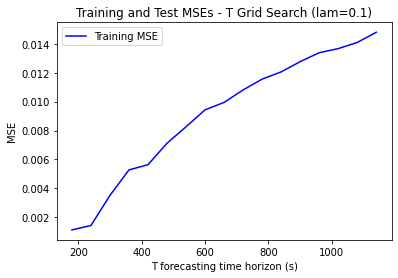

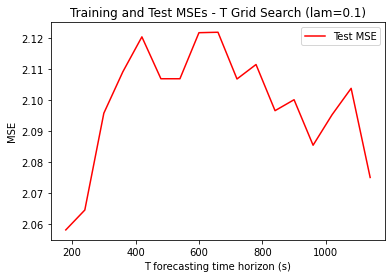

In [180]:
T_range = [field_temporal_resolution*i for i in range(3,20)] # [3 mins, 20 mins] in seconds
T_grid = T_grid_search(field_data_df,T_range, field_temporal_resolution,x_features, y_features, model_type, lam, historical_training_interval_count)

In [ ]:
lambdas = np.logspace(-4,4, 30)
lambda_grid = lambda_grid_search(field_data_df,lambdas, field_T, field_temporal_resolution,x_features, y_features, model_type, historical_training_interval_count)